**OBJECTIVE:** Run modSAR algorithm on QSAR datasets 

In [32]:
import math
import numpy as np
import pandas as pd

# Import relevant modSAR classes 
from modSAR.network_algorithms import ModSAR
from modSAR.cdk_utils import CDKUtils
from modSAR.datasource import GenericFileDataSource
from modSAR.preprocessing import *
from modSAR.dataset import QSARDataset

from rdkit import Chem
from rdkit.Chem import AllChem
import rdkit.Geometry
from rdkit.Chem import rdFMCS
from rdkit.Chem.Draw import IPythonConsole 

#from gevent import monkey
#monkey.patch_all()

# 2.5uM in Log units
CUTOFF_ACTIVITY = - np.log10(2.5e-06)

%matplotlib inline

# Load Data

In [33]:
# Read annotated training set compiled by wvanhoorn 
#  https://github.com/OpenSourceMalaria/Series4_PredictiveModel/issues/1#issuecomment-523037719

X = pd.read_excel('/mnt/data/Master Chemical List - annotated.xlsx')
X['pIC50'] = -np.log10(X['Value']* 1e-06)

In [34]:
X.iloc[0]

OSM_ID                                                               OSM-A-1
Series                                                                     1
Assay                                                        Pfal IC50 (Guy)
Value                                                                   3.05
Qualifier                                                                  =
PfaI EC50 (Inh)                                                          NaN
Pfal IC50 (GSK)                                                          NaN
Pfal IC50 (Syngene)                                                      NaN
Pfal IC50 (Dundee)                                                       NaN
Pfal IC50 (Avery)                                                        NaN
Pfal (K1) IC50 (Avery)                                                   NaN
Pfal IC50 (Ralph)                                                        NaN
Pfal IC50 (Guy)                                                         3.05

In [35]:
# Save this preprocessed dataset
X.to_excel('/mnt/data/malaria_osm4_train.xlsx')

In [36]:
# Read the bioactivities in a more standard way with modSAR package

malaria_osm4 = GenericFileDataSource(target_id='malaria_osm4', 
                                     filepath='/mnt/data/malaria_osm4_train.xlsx', 
                                     smiles_column='Canonical_Smiles', 
                                     compound_id_column='OSM_ID', 
                                     activity_column='pIC50',
                                     apply_filter=True)

In [6]:
malaria_osm4.bioactivities_df.head(3)

,OSM_ID,Series,Assay,Value,Qualifier,PfaI EC50 (Inh),Pfal IC50 (GSK),Pfal IC50 (Syngene),Pfal IC50 (Dundee),Pfal IC50 (Avery),Pfal (K1) IC50 (Avery),Pfal IC50 (Ralph),Pfal IC50 (Guy),Pfal (K1) IC50 (Guy),Pfal IC50 (Batra),Pfal (K1) IC50 (Batra),Pfal (3D7) IC50 (Broad),Pfal (Dd2) IC50 (Broad),Canonical_Smiles,InChIKey,pIC50
0,OSM-A-1,1,Pfal IC50 (Guy),3.050,=,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.050,4.379,NaN,NaN,NaN,NaN,Cc1cc(\C=C\2/S\C(=N/c3ccccc3)\NC2=O)c(C)n1c4cc...,ODRSSOQWOHNABY-MOSHPQCFSA-N,5.515700
1,OSM-A-1,1,Pfal (K1) IC50 (Guy),4.379,=,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.050,4.379,NaN,NaN,NaN,NaN,Cc1cc(\C=C\2/S\C(=N/c3ccccc3)\NC2=O)c(C)n1c4cc...,ODRSSOQWOHNABY-MOSHPQCFSA-N,5.358625
2,OSM-A-2,1,Pfal IC50 (Guy),0.574,=,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.574,1.829,NaN,NaN,NaN,NaN,Cc1cc(\C=C\2/S\C(=N/c3ccccc3)\NC2=O)c(C)n1c4cc...,LXPLFPVISCVJSC-BKUYFWCQSA-N,6.241088


In [37]:
print("Number of compounds: %d | Number of unique compounds: %d" %
      (malaria_osm4.bioactivities_df.shape[0], malaria_osm4.bioactivities_df['OSM_ID'].nunique()))

Number of compounds: 440 | Number of unique compounds: 348


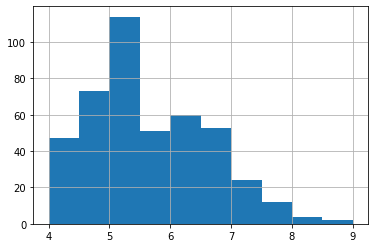

In [8]:
malaria_osm4.bioactivities_df['pIC50'].hist()

## Build QSAR Dataset

In [7]:
# build_qsar_dataset method performs a couple of preprocessing steps:
#  1. Treats duplicated values: A compound is discarded if it has many duplicated compounds and 
#                                 sd(pIC50) > 1 in its group of measurements
#  2. Calculates Molecular Descriptors: Using CDK library (Java)
#  3. Returns a QSARDataset: a python object that encapsulates a full dataset
osm4_dataset = malaria_osm4.build_qsar_dataset(calculate_similarity=False)

(01/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.WHIMDescriptor()
(02/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.BCUTDescriptor()
(03/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.XLogPDescriptor()
(04/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.WeightDescriptor()
(05/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.RuleOfFiveDescriptor()
(06/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.RotatableBondsCountDescriptor()
(07/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.MannholdLogPDescriptor()
(08/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.LargestPiSystemDescriptor()
(09/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.LargestChainDescriptor()
(10/49) Collecting descriptors from class self.cdk.qsar.descriptors.molecular.BondCountDescrip

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████-------------------------------------------------------------------------------------| 15.2% 

 |████████████████████--------------------------------------------------------------------------------| 20.6% 

 |██████████████████████████████████████--------------------------------------------------------------| 38.8% 

 |█████████████████████████████████████████████████████████████---------------------------------------| 61.0% 

 |████████████████████████████████████████████████████████████████████████████████████████████████████| 100.0% 
 |████████████████████████████████████████████████████████████████████████████████████████████████████| 100.0% 


In [10]:
osm4_dataset

QSARDataset malaria_osm4 
 -- Samples : 348
 -- Features:  95

In [16]:
osm4_dataset.metadata = osm4_dataset.metadata.set_index('OSM_ID')

## Apply cutoff

https://github.com/OpenSourceMalaria/Series4_PredictiveModel/issues/1#issuecomment-524913974

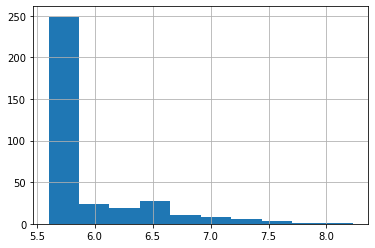

In [10]:
osm4_dataset.y[osm4_dataset.y < CUTOFF_ACTIVITY] = 0
osm4_dataset.y.hist()

## Similarity on Molecular Descriptors Space

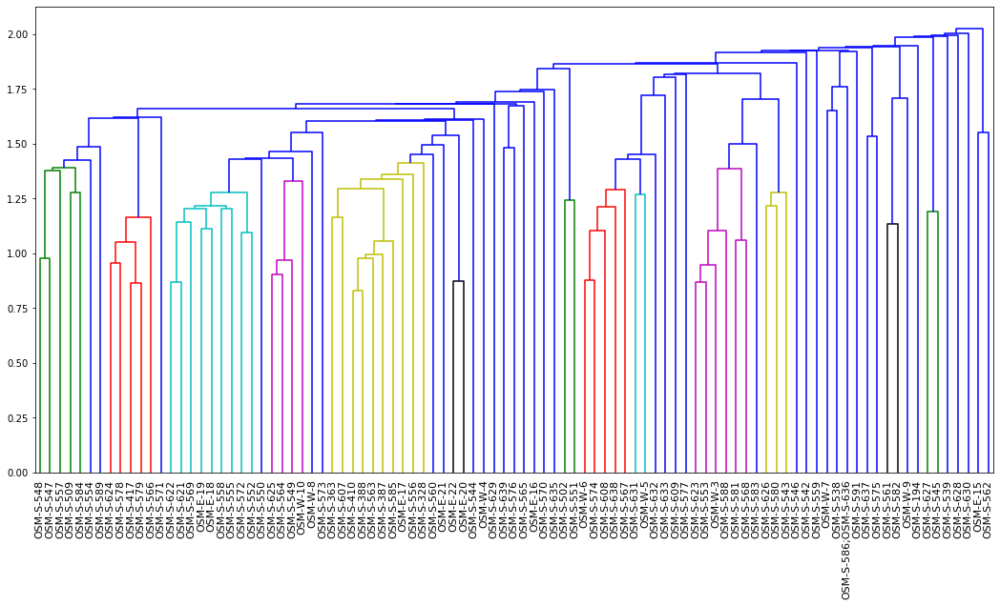

In [13]:
from scipy.cluster.hierarchy import dendrogram, linkage
from matplotlib import pyplot as plt

linked = linkage(osm4_dataset.X.corr(), 'single')

labelList = osm4_dataset.X.index

plt.figure(figsize=(18, 9))
dendrogram(linked,
            orientation='top',
            labels=labelList,
            distance_sort='descending',
            show_leaf_counts=True,
            leaf_font_size=11)
plt.show()

In [12]:
osm4_dataset.X_norm

,BCUTw-1l,BCUTw-1h,BCUTc-1l,BCUTc-1h,BCUTp-1l,BCUTp-1h,XLogP,LipinskiFailures,nRotB,MLogP,nAtomP,nAtomLC,nBase,ALogP,AMR,nSmallRings,nAromRings,nRingBlocks,nRings5,nRings6,WTPT-2,WTPT-3,WTPT-4,WTPT-5,TopoPSA,MDEC-11,MDEC-22,MDEC-23,MDEC-33,MDEO-11,MDEO-12,MDEO-22,MDEN-13,MDEN-22,MDEN-23,MDEN-33,khs.sCH3,khs.ssCH2,khs.dsCH,khs.aaCH,...,khs.sF,khs.ssS,khs.aaS,khs.ddssS,khs.sCl,Kier3,HybRatio,FMF,SP-6,VP-7,SPC-4,SC-3,SC-4,SC-5,SC-6,VC-3,VC-4,VC-5,VC-6,VCH-5,C1SP2,C2SP2,C3SP2,C1SP3,C2SP3,C3SP3,ATSp4,ATSm1,ATSm4,ATSm5,ATSc1,ATSc2,ATSc3,ATSc4,ATSc5,tpsaEfficiency,nHBDon,nHBAcc,bpol,topoShape
OSM_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
OSM-A-1,1.000000e+00,0.159139,0.721488,0.370696,0.667984,0.472452,0.345528,0.0,0.285714,0.625000,0.916667,0.65,1.0,0.573647,0.626831,0.230769,0.333333,0.75,0.4,0.333333,0.441483,0.379032,0.497353,0.353321,0.738964,0.166667,0.380400,0.468247,0.379402,0.160105,0.000000,0.000000,0.153274,0.124587,0.080070,0.000000,0.50,0.000000,0.333333,0.5625,...,0.000,0.5,0.0,0.5,0.0,0.561634,0.162338,0.655914,0.421271,0.199648,0.569884,0.392276,0.065634,0.505542,0.122474,0.387110,0.064624,0.144396,0.032159,0.049752,0.1,0.739130,0.25,0.222222,0.000000,0.000000,0.617380,0.226062,0.426127,0.483673,0.235648,0.819556,0.614055,0.214382,0.622465,0.539355,0.666667,0.555556,0.595851,0.833333
OSM-A-2,6.905554e-01,0.159126,0.001835,0.504389,0.321427,0.470714,0.456688,0.0,0.214286,0.791667,0.833333,0.65,1.0,0.681063,0.588591,0.230769,0.333333,0.75,0.4,0.333333,0.519003,0.205585,0.174089,0.356668,0.463461,0.166667,0.439128,0.507216,0.379402,0.000000,0.000000,0.000000,0.153274,0.124587,0.080070,0.000000,0.50,0.000000,0.333333,0.5625,...,0.000,0.5,0.0,0.0,0.0,0.502774,0.162338,0.737274,0.392194,0.179700,0.414168,0.208310,0.000000,0.246592,0.000000,0.282526,0.000000,0.101148,0.000000,0.049752,0.1,0.695652,0.50,0.222222,0.000000,0.000000,0.510930,0.152682,0.337941,0.410668,0.181175,0.878779,0.566525,0.216371,0.626850,0.392375,0.333333,0.333333,0.429239,0.833333
OSM-A-3,1.549842e-13,1.000000,0.721678,0.324035,0.668249,0.505601,0.574971,0.5,0.214286,0.750000,0.750000,0.60,1.0,0.772942,0.640913,0.230769,0.333333,0.75,0.4,0.333333,0.523825,0.206625,0.174086,0.260835,0.316998,0.166667,0.380400,0.468247,0.379402,0.000000,0.000000,0.000000,0.000000,0.124587,0.080070,0.000000,0.50,0.000000,0.333333,0.5625,...,0.000,0.5,0.0,0.0,0.0,0.474342,0.162338,0.782313,0.370988,0.222735,0.404551,0.220218,0.000000,0.246592,0.000000,0.412582,0.000000,0.101148,0.000000,0.049752,0.1,0.739130,0.25,0.222222,0.000000,0.000000,0.557191,0.981358,0.508855,0.486129,0.112285,0.905036,0.594636,0.218460,0.637505,0.192452,0.333333,0.222222,0.495726,1.000000
OSM-E-1,1.192186e-13,0.159126,0.695116,0.326747,0.292127,0.599361,0.202533,0.0,0.357143,0.375000,0.375000,0.40,0.0,0.315025,0.322764,0.076923,0.166667,0.25,0.2,0.166667,0.107760,0.301633,0.495947,0.234020,0.452995,0.405480,0.157264,0.214842,0.167366,0.286998,0.000000,0.000000,0.401364,0.000000,0.000000,0.250000,0.75,0.083333,0.000000,0.2500,...,0.125,0.0,0.0,0.5,0.0,0.369238,0.476190,0.204969,0.199105,0.083269,0.529258,0.313680,0.037894,0.574142,0.157735,0.294256,0.050058,0.183808,0.074416,0.014756,0.1,0.434783,0.00,0.333333,0.000000,0.000000,0.437443,0.127590,0.318948,0.420966,0.248266,0.841009,0.497411,0.378052,0.408075,0.468459,0.333333,0.444444,0.521799,1.000000
OSM-E-2,9.621198e-01,0.159126,0.620015,0.321854,0.291512,0.550897,0.181514,0.0,0.357143,0.333333,0.375000,0.40,0.0,0.280361,0.288157,0.076923,0.166667,0.25,0.2,0.166667,0.139441,0.297279,0.496849,0.225444,0.507111,0.166667,0.157264,0.214842,0.167366,0.286998,0.000000,0.000000,0.131377,0.000000,0.064864,0.000000,0.50,0.083333,0.000000,0.2500,...,0.125,0.0,0.0,0.5,0.0,0.387416,0.382653,0.238095,0.193257,0.074489,0.415223,0.304620,0.046410,0.329408,0.070711,0.227183,0.055966,0.112402,0.024119,0.014756,0.1,0.434783,0.00,0.333333,0.000000,0.000000,0.362387,0.120007,0.271496,0.374039,0.236205,0.890486,0.401052,0.35294

In [27]:
QSARDatasetIO.write(osm4_dataset, filepath='/mnt/data/OSM-S4/osm4_qsardataset.xls')

In [31]:
QSARDatasetIO.load(dataset_name='OSM4',
                   activity_sheetname='activity',
                   smiles_column='Canonical_Smiles',
                   id_column='OSM_ID',
                   filepath='/mnt/data/OSM-S4/osm4_qsardataset.xls',
                   calculate_similarity=False)

QSARDataset OSM4 
 -- Samples : 348
 -- Features:  95

## Calculate Pairwise Similarity

We need to compute the Tanimoto similarity between all compounds before running the algorithm. 

This can be done with the function `calculate_pairwise_tanimoto` from `CDKUtils` class:

In [19]:
osm4_dataset

QSARDataset malaria_osm4 
 -- Samples : 348
 -- Features:  95

In [20]:
cdk_utils = CDKUtils()
# Pass a DataFrame and inform the column that contain SMILES code
similarity_matrix = cdk_utils.calculate_pairwise_tanimoto(osm4_dataset.metadata['Canonical_Smiles'])

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |----------------------------------------------------------------------------------------------------| 0.8% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█---------------------------------------------------------------------------------------------------| 1.6% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-51 x OSM-S-630
Error while calculating fingerprint for C(Cc1ccccc1)Nc2nccn3c(nnc23)c4ccccc4.
 Original Error:
org.openscience.cdk.fingerprint does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))


ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████-----------------------------------------------------------------------| 29.7% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████----------------------------------------------------------------------| 30.5% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████---------------------------------------------------------------------| 31.3% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████--------------------------------------------------------------------| 32.1% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████-------------------------------------------------------------------| 33.8% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████------------------------------------------------------------------| 34.6% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████-----------------------------------------------------------------| 35.4% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████████----------------------------------------------------------------| 36.3% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████---------------------------------------------------------------| 37.1% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████---------------------------------------------------------------| 37.9% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████████--------------------------------------------------------------| 38.7% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-295 x OSM-S-300
Error while calculating fingerprint for Fc1cc(F)cc(c1)c2nnc3cncc(OCCc4ccccc4)n23.
 Original Error:
org.openscience.cdk.fingerprint does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))
ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primi

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████████████----------------------------------------------------------| 42.0% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████████████----------------------------------------------------------| 42.9% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████---------------------------------------------------------| 43.7% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████████████████--------------------------------------------------------| 44.5% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-393 x OSM-S-394
Error while calculating fingerprint for COC(COc1cncc2nnc(c3ccc(OC(F)F)cc3)n12)(OC)c4ccc(F)c(F)c4.
 Original Error:
org.openscience.cdk.fingerprint.CircularFingerprinter does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))
ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_o

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████████████████████-----------------------------------------| 59.8% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████████████████████████████---------------------------------------| 61.4% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████████████████████████████████--------------------------------------| 62.2% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████████████████████████-------------------------------------| 63.0% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████████████████████████████████████------------------------------------| 64.7% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████████████████████████████████-----------------------------------| 65.5% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████████████████████████████████████████████----------------------------| 72.1% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |████████████████████████████████████████████████████████████████████████----------------------------| 72.9% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████████████████████████████████████████---------------------------| 73.8% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████████████████████████████████████████████-----------------------| 77.1% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |█████████████████████████████████████████████████████████████████████████████-----------------------| 77.9% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████████████████████████████████████████---------------------| 79.1% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████████████████████████████████████████---------------------| 80.0% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-567 x OSM-S-568
Error while calculating fingerprint for FC(F)Oc1ccc(cc1)c2nnc3cncc(OCCc4cccc(OCc5ccccc5)c4)n23.
 Original Error:
org.openscience.cdk.fingerprint.CircularFingerprinter does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))
ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-363 x OSM-S-387
Error while calculating fingerprint for FC(F)Oc1ccc(cc1)c2nnc3c(SCCc4ccccc4)nccn23.
 Original Error:
org.openscience.cdk.fingerprint.CircularFingerprinter does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))
ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  Fil

 |██████████████████████████████████████████████████████████████████████████████████████████████------| 94.8% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

/mnt/code/modSAR/cdk_utils.py:209: UserWarning: Error calculating similarity: OSM-S-509 x OSM-S-621
Error while calculating fingerprint for FC(F)Oc1ccc(cc1)c2nnc3c(nccn23)N4CCOCC4.
 Original Error:
org.openscience.cdk.fingerprint.CircularFingerprinter does not exist in the JVM
  warnings.warn(error_msg % (df_smiles.index[i], df_smiles.index[j], e))


ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |██████████████████████████████████████████████████████████████████████████████████████████████████--| 98.5% 

ERROR:root:Exception while sending command.
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/py4j/java_gateway.py", line 1181, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
  File "/opt/conda/lib/python3.6/socket.py", line 586, in readinto
    return self._sock.recv_into(b)
  File "/opt/conda/lib/python3.6/site-packages/gevent/_socket3.py", line 433, in recv_into
    self._wait(self._read_event)
  File "src/gevent/_hub_primitives.py", line 284, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 289, in gevent.__hub_primitives.wait_on_socket
  File "src/gevent/_hub_primitives.py", line 271, in gevent.__hub_primitives._primitive_wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 46, in gevent.__hub_primitives.WaitOperationsGreenlet.wait
  File "src/gevent/_hub_primitives.py", line 55, in gevent

 |███████████████████████████████████████████████████████████████████████████████████████████████████-| 99.9% 

 |████████████████████████████████████████████████████████████████████████████████████████████████████| 100.0% 


Similarity is encoded as a numpy matrix

In [21]:
similarity_matrix.write_csv('/mnt/data/OSM-S4/similarity_values.csv')

OSM_ID,OSM-A-1,OSM-A-2,OSM-A-3,OSM-E-1,OSM-E-2,OSM-E-3,OSM-E-4,OSM-E-5,OSM-E-6,OSM-E-7,OSM-E-8,OSM-L-1,OSM-S-10,OSM-S-108,OSM-S-109,OSM-S-110,OSM-S-111,OSM-S-112,OSM-S-114,OSM-S-115,OSM-S-116,OSM-S-138,OSM-S-16,OSM-S-19,OSM-S-2,OSM-S-21,OSM-S-3,OSM-S-35,OSM-S-37,OSM-S-38,OSM-S-39,OSM-S-4,OSM-S-42,OSM-S-43,OSM-S-45,OSM-S-48,OSM-S-49,OSM-S-5,OSM-S-50,OSM-S-51,...,OSM-W-10,OSM-W-3,OSM-W-5,OSM-W-6,OSM-W-7,OSM-W-8,OSM-W-9,OSM-E-15,OSM-E-16,OSM-E-17,OSM-E-18,OSM-E-19,OSM-E-20,OSM-E-21,OSM-E-22,OSM-S-328,OSM-S-363,OSM-S-387,OSM-S-388,OSM-S-410,OSM-S-417,OSM-S-502,OSM-S-509,OSM-S-543,OSM-S-561,OSM-S-563,OSM-S-569,OSM-S-570,OSM-S-621,OSM-S-622,OSM-S-625,OSM-S-627,OSM-S-628,OSM-S-629,OSM-S-630,OSM-S-631,OSM-S-632,OSM-S-633,OSM-W-4,OSM-S-194
OSM_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
OSM-A-1,0.000000,0.754098,0.775862,0.250000,0.256757,0.194805,0.083333,0.091954,0.094118,0.082353,0.096386,0.472222,0.762712,0.550000,0.714286,0.591549,0.737705,0.608696,0.682540,0.704918,0.236842,0.793103,0.156627,0.223684,0.317460,0.224719,0.216216,0.800000,0.789474,0.737705,0.661538,0.231884,0.448718,0.390244,0.387500,0.661765,0.386667,0.226667,0.389610,0.666667,...,0.054348,0.120879,0.139785,0.103093,0.090000,0.064516,0.084211,0.084211,0.095745,0.100000,0.097561,0.073171,0.068966,0.099010,0.068627,0.071429,0.085106,0.067416,0.050000,0.106383,0.077778,0.080808,0.054348,0.063830,0.086957,0.086957,0.085106,0.087912,0.084337,0.089888,0.087912,0.087912,0.083333,0.086957,0.083333,0.108696,0.087912,0.086957,0.096774,0.103448
OSM-A-2,0.754098,0.000000,0.789474,0.220779,0.226667,0.166667,0.097561,0.105882,0.108434,0.096386,0.111111,0.478873,0.775862,0.559322,0.725806,0.600000,0.779661,0.641791,0.693548,0.716667,0.256757,0.807018,0.158537,0.226667,0.322581,0.227273,0.236111,0.814815,0.803571,0.750000,0.671875,0.235294,0.513514,0.430380,0.392405,0.696970,0.391892,0.246575,0.394737,0.650794,...,0.066667,0.086022,0.105263,0.191011,0.173913,0.152941,0.172414,0.172414,0.186047,0.195122,0.202703,0.175676,0.069767,0.182796,0.148936,0.085366,0.097826,0.080460,0.050633,0.119565,0.103448,0.092784,0.078652,0.076087,0.087912,0.100000,0.097826,0.101124,0.098765,0.103448,0.101124,0.101124,0.084337,0.087912,0.084337,0.122222,0.101124,0.087912,0.122222,0.117647
OSM-A-3,0.775862,0.789474,0.000000,0.216216,0.222222,0.160000,0.088608,0.097561,0.100000,0.087500,0.088608,0.507463,0.833333,0.600000,0.775862,0.636364,0.803571,0.656250,0.741379,0.767857,0.236111,0.833333,0.166667,0.222222,0.344828,0.238095,0.231884,0.880000,0.865385,0.803571,0.716667,0.250000,0.479452,0.397436,0.413333,0.714286,0.414286,0.225352,0.416667,0.694915,...,0.057471,0.077778,0.097826,0.096774,0.083333,0.056180,0.076923,0.076923,0.088889,0.093023,0.089744,0.064103,0.073171,0.092784,0.061224,0.075949,0.089888,0.071429,0.039474,0.112360,0.082353,0.085106,0.057471,0.067416,0.079545,0.091954,0.089888,0.093023,0.089744,0.095238,0.093023,0.093023,0.088608,0.091954,0.088608,0.102273,0.093023,0.091954,0.127907,0.109756
OSM-E-1,0.250000,0.220779,0.216216,0.000000,0.632653,0.717391,0.238095,0.242424,0.250000,0.234375,0.300000,0.240000,0.300000,0.095890,0.202532,0.190476,0.207792,0.195122,0.192308,0.197368,0.446429,0.229730,0.169014,0.509434,0.458333,0.333333,0.452830,0.211268,0.219178,0.240000,0.202532,0.469388,0.234568,0.262500,0.272727,0.234568,0.246575,0.519231,0.253333,0.150000,...,0.150685,0.202703,0.162500,0.146341,0.142857,0.162162,0.125000,0.125000,0.097561,0.116883,0.054795,0.102941,0.142857,0.126437,0.142857,0.084507,0.098765,0.108108,0.059701,0.123457,0.090909,0.080460,0.090909,0.101266,0.144737,0.101266,0.098765,0.102564,0.100000,0.105263,0.102564,0.102564,0.098592,0.101266,0.098592,0.072289,0.102564,0.101266,0.126582,0.064103
OSM-E-2,0.256757,0.226667,0.222222,0.632653,0.000000,0.480769,0.245902,0.250000,0.258065,0.241935,0.310345,0.263889,0.308824,0.098592,0.207792,0.195122,0.213333,0.200000,0.197368,0.202703,0.462963,0.236111,0.208955,0.625000,0.478261,0.382353,0